**DataSet Introduction**

This is a dataset: https://www.kaggle.com/datasets/jacksondivakarr/car-crash-dataset?select=new+dataset.xlsx I found on kaggle showing car crashes from the year 2003-2015 on car accidents across monroe county. It has datapoints on year, day, hour, collision type, injury type, primary reason for the accident, location of the accident, as well as the latitude and longitutde of the accident. 

**Imported Tools**

Tools that I imported were pandas, for data manipulation. numpy, for computations. matplotlib, for visualizations like bar charts and line charts. seaborn for visualizations like the correlation table that use heatmaps. and plotly express, for interactive graphs used in the map.  as well as a multitude of scikit learns that I did not use hwoever imported just incase. 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import LabelEncoder

file_path = "C:/Users/19258/Downloads/new dataset.xlsx"
data = pd.read_excel(file_path)
display(data.head())
data.info()

,Year,Month,Day,Weekend?,Hour,Collision Type,Injury Type,Primary Factor,Reported_Location,Latitude,Longitude
0,2015,1,5,Weekday,0.0,2-Car,No injury/unknown,OTHER (DRIVER) - EXPLAIN IN NARRATIVE,1ST & FESS,39.159207,-86.525874
1,2015,1,6,Weekday,1500.0,2-Car,No injury/unknown,FOLLOWING TOO CLOSELY,2ND & COLLEGE,39.161440,-86.534848
2,2015,1,6,Weekend,2300.0,2-Car,Non-incapacitating,DISREGARD SIGNAL/REG SIGN,BASSWOOD & BLOOMFIELD,39.149780,-86.568890
3,2015,1,7,Weekend,900.0,2-Car,Non-incapacitating,FAILURE TO YIELD RIGHT OF WAY,GATES & JACOBS,39.165655,-86.575956
4,2015,1,7,Weekend,1100.0,2-Car,No injury/unknown,FAILURE TO YIELD RIGHT OF WAY,W 3RD,39.164848,-86.579625


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53943 entries, 0 to 53942
Data columns (total 11 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Year               53943 non-null  int64  
 1   Month              53943 non-null  int64  
 2   Day                53943 non-null  int64  
 3   Weekend?           53875 non-null  object 
 4   Hour               53718 non-null  float64
 5   Collision Type     53937 non-null  object 
 6   Injury Type        53943 non-null  object 
 7   Primary Factor     52822 non-null  object 
 8   Reported_Location  53908 non-null  object 
 9   Latitude           53913 non-null  float64
 10  Longitude          53913 non-null  float64
dtypes: float64(3), int64(3), object(5)
memory usage: 4.5+ MB


**Question**

The overarching question that I had was if there is a relation betweeen any of these factors in causing car accidents, and which factors play the largest role. Furthermore how do these different aspects of car accidents relate to one another. 

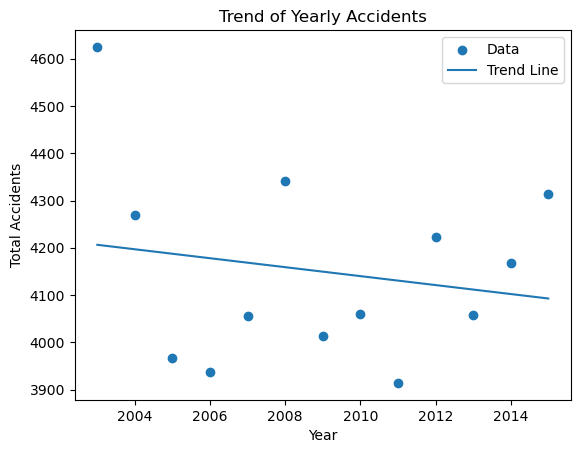

Intercept: 23168.73076923077
Slope: -9.467032967032967


In [3]:
accidents_per_year = data.groupby("Year").size().reset_index(name="Total Accidents")

X = accidents_per_year["Year"].values.reshape(-1, 1)
y = accidents_per_year["Total Accidents"].values

model = LinearRegression()
model.fit(X, y)

plt.scatter(X, y, label="Data")
plt.plot(X, model.predict(X), label="Trend Line")
plt.xlabel("Year")
plt.ylabel("Total Accidents")
plt.title("Trend of Yearly Accidents")
plt.legend()
plt.show()

print("Intercept:", model.intercept_)
print("Slope:", model.coef_[0])

**Trend of Yearly Accidents Analysis**

This is a graph showing the trend of accidents across each year, using a linear regression model we see that it suggests a negative trend of around 9.47 however thats mainly due to the extreme outlier year in 2003, outside of that we can see that the accidents per year are generally within 500 accidents per year of eachother with esetialy random variation each year. 

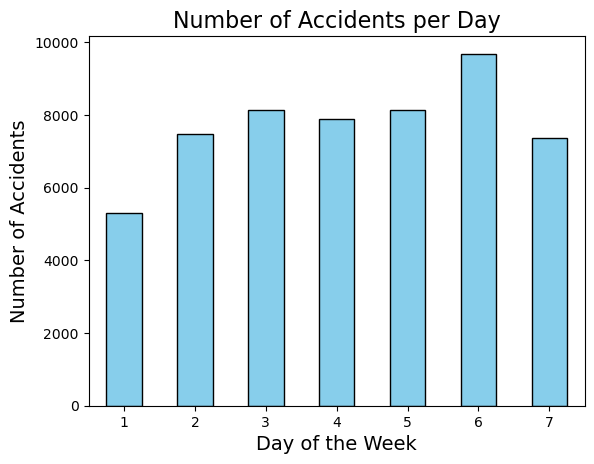

In [4]:
accidents_per_day = data["Day"].value_counts().sort_index()

accidents_per_day.plot(kind="bar", color="skyblue", edgecolor="black")
plt.title("Number of Accidents per Day", fontsize=16)
plt.xlabel("Day of the Week", fontsize=14)
plt.ylabel("Number of Accidents", fontsize=14)
plt.xticks(rotation=0)
plt.show()

**Number of Accidents per Day Analysis** 

This graph is showing the total number of accidents per day across 2003-2015, one thing about the dataset that is important to note is that day 1 is monday. we can see that the day with the most accidents is saturday and the day with the lowest is monday all the other days of the week are fairly simmilar in terms of number of accidents per day.

In [5]:
total_accidents_per_day = data.groupby("Day").size()
average_accidents_per_day = total_accidents_per_day / data["Year"].nunique()

for day, avg_accidents in average_accidents_per_day.items():
    print(f"Day: {day}, Average Accidents: {avg_accidents:.2f}")

Day: 1, Average Accidents: 407.00
Day: 2, Average Accidents: 574.85
Day: 3, Average Accidents: 625.62
Day: 4, Average Accidents: 606.15
Day: 5, Average Accidents: 624.77
Day: 6, Average Accidents: 744.62
Day: 7, Average Accidents: 566.46


In [6]:
average_accidents_1_to_5 = average_accidents_per_day.loc[1:5].mean()
average_accidents_6_to_7 = average_accidents_per_day.loc[6:7].mean()

print(f"Average Accidents (Weekdays): {average_accidents_1_to_5:.2f}")
print(f"Average Accidents (Weekends): {average_accidents_6_to_7:.2f}")

Average Accidents (Weekdays): 567.68
Average Accidents (Weekends): 655.54


**Average Accidents Data**

The above data is taking the data derived from the graph to get a better undertsnanding of a per year basis. To help put an average on the above graph to get another way of understanding the graph. Furthermore I grouped the averages from above setting days 1-5 as the weekdays and days 6-7 as the weekends to see if there is any relation between the number of accidents on the weekday versus the weekend. It is clear that the weekend averages almost 90 more accidents than the weekdays, With the most accidents being on Saturday, and the least being on Monday.

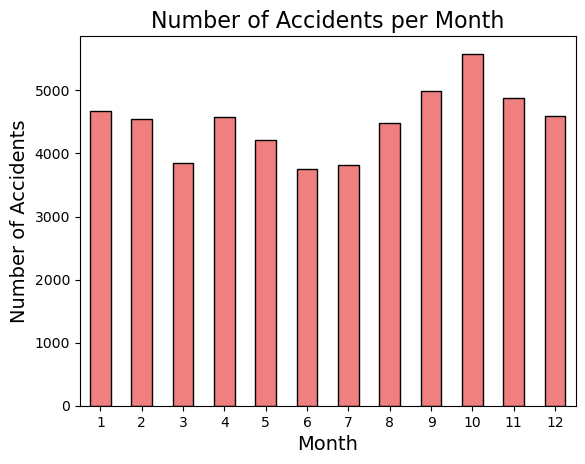

In [7]:
accidents_per_month = data["Month"].value_counts().sort_index()

accidents_per_month.plot(kind="bar", color="lightcoral", edgecolor="black")
plt.title("Number of Accidents per Month", fontsize=16)
plt.xlabel("Month", fontsize=14)
plt.ylabel("Number of Accidents", fontsize=14)
plt.xticks(ticks=range(12), rotation=0)
plt.show()

**Month/Season Accident Analysis**

This is a bar graph depicting the total number of accidents from 2003-2015 per month. we see that the months with the lowest accidents are march, june and july. We also see a rise start in august with a peak number of accidents in october. Generally we see that the fall seasons are responsible for a greater number of accidents in comparison to other seasons. This is most likely due to the poorer weather in the fall season. 

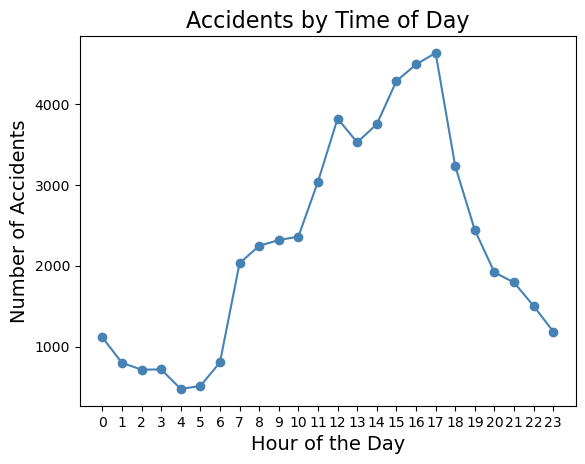

In [8]:
accidents_by_hour = data["Hour"].value_counts().sort_index()

plt.plot(accidents_by_hour.values, marker='o', color='steelblue')
plt.title("Accidents by Time of Day", fontsize=16)
plt.xlabel("Hour of the Day", fontsize=14)
plt.ylabel("Number of Accidents", fontsize=14)
plt.xticks(ticks=range(0, 24), labels=[str(i) for i in range(24)], rotation=0)
plt.show()

**Analysis on Relation Between Time of Day and Accidents Freqeuncy**

This is a line graph showing the total number of accidents by the time of day from 2003-2015 in military time. We see that the lowest number of accidents happen at 4 in the morning however starting 6AM to 8AM there is a massive increase, as well as from 10AM to 12PM. after a slight decline to 13(1PM) from then to 17(5PM) there is a massive spike hitting its peak at 17(5). from 17(5) onwards there is a decline. This has a strong relation to human work times and rush hour as can see it is interesting to note that the evening traffic rush is associated with much more accidents than the morning traffic rush. 

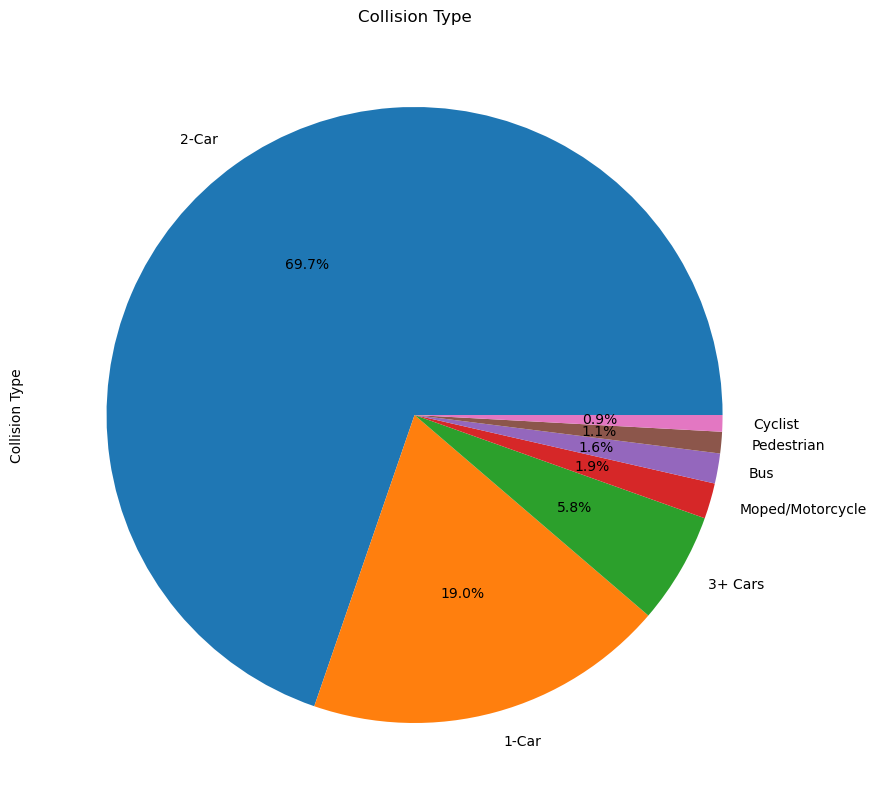

In [9]:
collision_type_counts = data["Collision Type"].value_counts()

plt.figure(figsize=(10, 10))
collision_type_counts.plot.pie(autopct="%1.1f%%", startangle=0)
plt.title("Collision Type")
plt.show()

**Most Common Accident Types**

This is a pie chart shoing the percentage of collision types from 2003-2015. We see that 2 car accidents are by far the most common accident type at 67.9 percent followed by 1 car at 19 percent and 3 car at 5.8 percent. other accident types include, 3+ cars, moped, bus, pedestrian and motorcycle

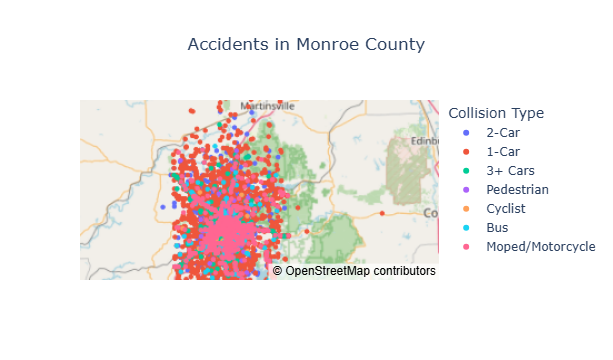

In [4]:
locations = data[['Latitude', 'Longitude', 'Reported_Location', "Hour", "Collision Type", "Injury Type", "Primary Factor"]].dropna()

fig = px.scatter_mapbox(
    locations,
    lat="Latitude",
    lon="Longitude",
    hover_name="Reported_Location",
    hover_data={"Hour": True, "Injury Type": True, "Primary Factor": True,"Latitude": False, "Longitude": False,},
    color="Collision Type",
    title="Interactive Map of Locations",
    mapbox_style="open-street-map",
    zoom=8,
)

fig.update_layout(
    mapbox=dict( center={"lat": 39.25, "lon": -86.45}),
    title="Accidents in Monroe County ",
    title_x=0.5
    
)

fig.show()

**Accident Visualization**

This is a map using longitutude and latitude from every accident from 2003-2015 representing the location of every accident. Each accident is colorcoded so you know the collsion type of the accident on the map. furthermore it also shows the injuty type, primary factor as well as the hour in which the accident happened. This data is based around Bloomington Indiana and we can see that most the accidents are happening alonng the major roads in the heart of the city rather than suburban areas. 

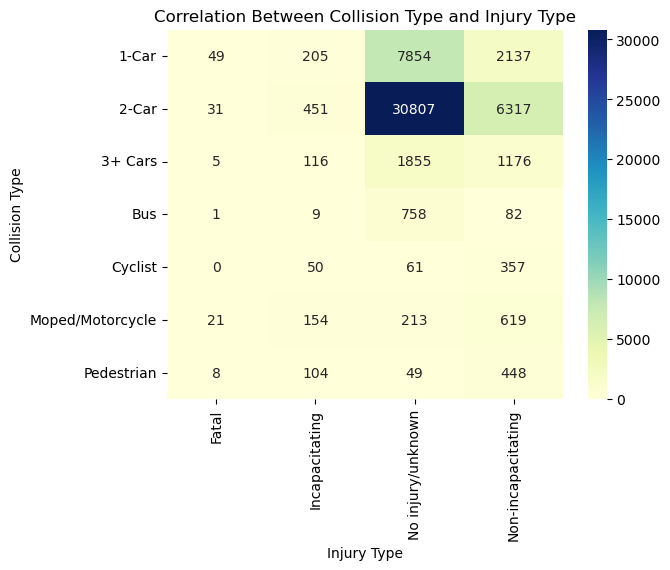

In [15]:
collision_injury_data = data[['Collision Type', 'Injury Type']]
correlation = pd.crosstab(collision_injury_data['Collision Type'], collision_injury_data['Injury Type'])

sns.heatmap(correlation, annot=True, fmt="d", cmap="YlGnBu")
plt.title('Correlation Between Collision Type and Injury Type')
plt.xlabel('Injury Type')
plt.ylabel('Collision Type')
plt.show()

**Relation Between Collision Type and Injury Type**

This is a heatmap of sorts that shows the relation between collision type and injury type mainly to get an understanding of what the relation between accident types and injury types are. we see the most common outcome is no injury across all accident types interesting to note is that motorcycles who make up 1.9 % of accidents have the highest fatality rate at 2.1% followed by pedestrians at 1.31%. Due to high frequency we see that 2 car collisions have the an extremley low ftality rate at 0.08%, the lowest is cyclist at 0%

In [19]:
primary_factor_counts = data['Primary Factor'].value_counts()

primary_factor_table = pd.DataFrame({
    'Primary Factor': primary_factor_counts.index,
    'Number of Accidents': primary_factor_counts.values
})
print(primary_factor_table)

                              Primary Factor  Number of Accidents
0              FAILURE TO YIELD RIGHT OF WAY                11193
1                      FOLLOWING TOO CLOSELY                 7359
2      OTHER (DRIVER) - EXPLAIN IN NARRATIVE                 6158
3                             UNSAFE BACKING                 5188
4                         RAN OFF ROAD RIGHT                 2925
5                  DISREGARD SIGNAL/REG SIGN                 2206
6      SPEED TOO FAST FOR WEATHER CONDITIONS                 1921
7                           IMPROPER TURNING                 1843
8                   ANIMAL/OBJECT IN ROADWAY                 1688
9   DRIVER DISTRACTED - EXPLAIN IN NARRATIVE                 1656
10                              UNSAFE SPEED                 1499
11                 ROADWAY SURFACE CONDITION                 1270
12                            LEFT OF CENTER                 1078
13                       IMPROPER LANE USAGE                  985
14        

**Most Common Reason for Accidents**

this shows the top reasons for accidents across 2003-2015 we see that faliure to yield right of way is the most common by a large margin and utility work is the least common

In [38]:
top_20_locations = data['Reported_Location'].value_counts().head(20)

top_20_locations_df = top_20_locations.reset_index()
top_20_locations_df.columns = ['Reported_Location', 'Count']

print(top_20_locations_df)

        Reported_Location  Count
0                E 3RD ST    375
1                W 3RD ST    222
2          SR37N & VERNAL    197
3                  3RD ST    195
4             S WALNUT ST    172
5               E 10TH ST    153
6             N WALNUT ST    124
7       S COLLEGE MALL RD    123
8           SR37 & VERNAL    123
9               WALNUT ST    117
10         SR37S & VERNAL    113
11           SR37S & TAPP    112
12        3RD ST & JORDAN    108
13     10TH & COLLEGE AVE    105
14            EAST 3RD ST    104
15              E 17TH ST    102
16            SR37 & SR45     98
17  3RD ST & COLLEGE MALL     96
18               N FEE LN     94
19     13TH & INDIANA AVE     87


**Most Common Accident Locations**

This shows the top 20 reported locations and te amount of accidents that have occured, E 3rd street anis the most followed by W 3rd street the least out of the top 20 is 13th and indiana avenue

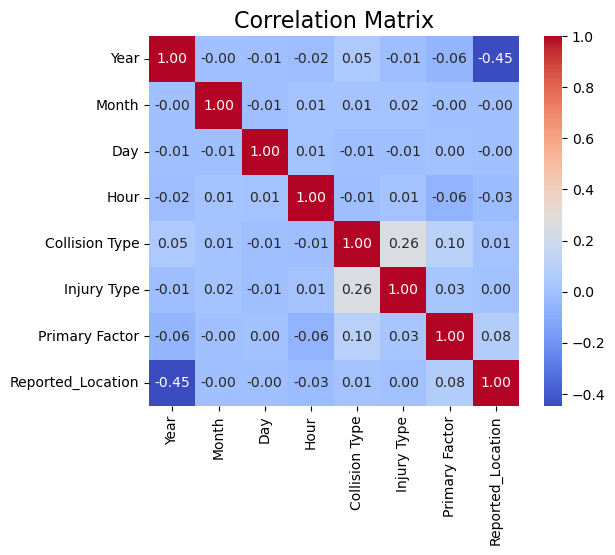

In [20]:

categorical_columns = ["Collision Type", "Injury Type", "Primary Factor", "Reported_Location"]
data[categorical_columns] = data[categorical_columns].apply(lambda col: pd.factorize(col)[0])

numeric_columns = ["Year", "Month", "Day", "Hour", "Collision Type", "Injury Type", "Primary Factor", "Reported_Location"]

updated_correlation_matrix = data[numeric_columns].corr()

sns.heatmap(updated_correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", cbar=True, square=True)
plt.title("Correlation Matrix", fontsize=16)
plt.show()

**Final Takeaways**

In summation we see there are factors that relate to increased accidents such as location, time of day, month, the day itself. However the relation between each factor is not as strong outside of collision type and injury type. With the possible exception of primary factor and collision type. My main takeway from this is that the relation between car accidents is something that cannot be necessairly seen on a correlation, but rather something that has to be nunanced when observing data. Accidents are entirley on humans and each person is different. The Human aspect plays the single most important role as such as how drivers change the way the drive during certain seasons, rush hour. lack of understanding road signs, not paying attention to the road and so on. The only real thing that we can do to reduce accidents is be simply following the rules and by being a smart and defensive driver.